# Combined Model

v1

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
### Initial imports
import logging
import numpy as np
import pandas as pd
import pymc3 as pm
import theano.tensor as T
import matplotlib.pyplot as plt

logging.basicConfig(level=logging.INFO)
log = logging.getLogger(__name__)

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

from epimodel.pymc3_models.utils import geom_convolution
from epimodel.pymc3_models import cm_effect
from epimodel.pymc3_models.cm_effect.datapreprocessor import DataPreprocessor


%matplotlib inline

1.00000000016935, mean is 23.85639871290625


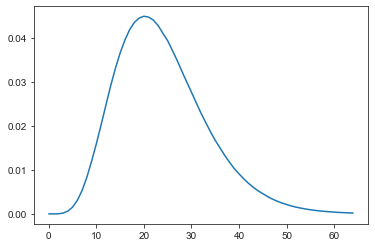

In [3]:
DelayProb = np.array(
            [
                0,
                2.10204045e-06,
                3.22312869e-05,
                1.84979560e-04,
                6.31412913e-04,
                1.53949439e-03,
                3.07378372e-03,
                5.32847235e-03,
                8.32057678e-03,
                1.19864352e-02,
                1.59626950e-02,
                2.02752812e-02,
                2.47013776e-02,
                2.90892369e-02,
                3.30827134e-02,
                3.66035310e-02,
                3.95327745e-02,
                4.19039762e-02,
                4.35677913e-02,
                4.45407357e-02,
                4.49607434e-02,
                4.47581467e-02,
                4.40800885e-02,
                4.28367817e-02,
                4.10649618e-02,
                3.93901360e-02,
                3.71499615e-02,
                3.48922699e-02,
                3.24149652e-02,
                3.00269472e-02,
                2.76836725e-02,
                2.52794388e-02,
                2.29349630e-02,
                2.07959867e-02,
                1.86809336e-02,
                1.67279378e-02,
                1.50166767e-02,
                1.33057159e-02,
                1.17490048e-02,
                1.03030011e-02,
                9.10633952e-03,
                7.97333972e-03,
                6.95565185e-03,
                6.05717970e-03,
                5.25950540e-03,
                4.61137626e-03,
                3.94442886e-03,
                3.37948046e-03,
                2.91402865e-03,
                2.48911619e-03,
                2.14007737e-03,
                1.81005702e-03,
                1.54339818e-03,
                1.32068199e-03,
                1.11358095e-03,
                9.53425490e-04,
                7.99876440e-04,
                6.76156345e-04,
                5.68752088e-04,
                4.93278826e-04,
                4.08596625e-04,
                3.37127249e-04,
                2.92283720e-04,
                2.41934846e-04,
                1.98392580e-04,
            ]
        )

plt.plot(DelayProb)
print(f"{np.sum(DelayProb)}, mean is {np.sum([i * DelayProb[i] for i in range(len(DelayProb))])}")

INFO:epimodel.regions:Name index has 7 potential conflicts: ['american samoa', 'georgia', 'guam', 'northern mariana islands', 'puerto rico', 'united states minor outlying islands', 'virgin islands (u.s.)']
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:
Countermeasures                               min   ... mean  ... max   ... unique
 1 Healthcare specialisation                  0.000 ... 0.038 ... 1.000 ... [0. 1.]
 2 Mask wearing over 70%                      0.000 ... 0.083 ... 1.000 ... [0. 1.]
 3 Gatherings limited to 1000                 0.000 ... 0.240 ... 1.000 ... [0. 1.]
 4 Gatherings limited to 100                  0.000 ... 0.215 ... 1.000 ... [0. 1.]
 5 Gatherings limited to 10                   0.000 ... 0.114 ... 1.000 ... [0. 1.]
 6 Business suspended - some                  0.000 ... 0.250 ... 1.000 ... [0. 1.]
 7 Business suspended - many                  0.000 ... 0.167 ... 1.000 ... [0. 1.]
 8 Schools and universities closed            0.000 ... 0.322 ... 1.

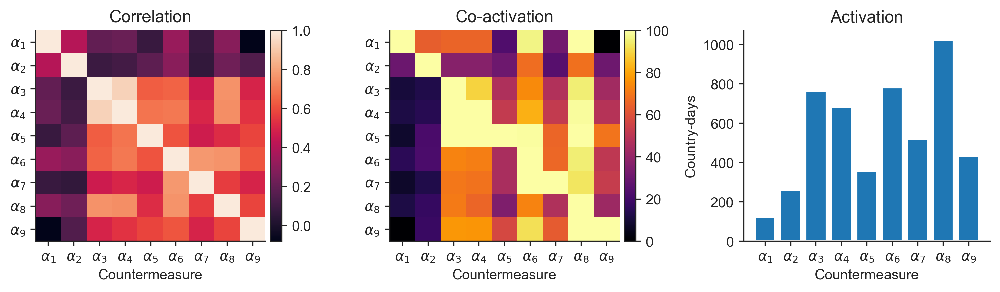

In [4]:
regions = ['AT', 'BE', 'CH', 'CZ', 'DE', 'DK', 'ES', 'FI', 'FR', 'GB', 'GR','HU', 'IE', 'IT', 'NL', 'PL', 'RO', 'RS', 'RU', 'SE']
# Same, outside Europe
regions += ['CN-HK', 'EG', 'IL', 'JP', 'KR', 'MX', 'MY', 'MA']


features = ['Healthcare specialisation', 
             'Mask wearing over 70%',
 'Gatherings limited to 1000',    
 'Gatherings limited to 100',
 'Gatherings limited to 10',
 'Business suspended - some',
 'Business suspended - many',
 'Schools and universities closed',
 'General curfew'
 ]

dp = DataPreprocessor(end_date="2020-04-21")
data = dp.preprocess_data("../../data", regions, features, selected_cm_set="countermeasures-model-boolean_Gat3Bus2SchCurHespMa.csv")

In [41]:
with cm_effect.models.CMCombined(data) as model:
    model.build_model()

/Users/mrinank/Library/Caches/pypoetry/virtualenvs/epimodel-H-ywULmv-py3.7/lib/python3.7/site-packages/pymc3/model.py:1430: ImputationWarning: Data in ObservedDeaths contains missing values and will be automatically imputed from the sampling distribution.
  warnings.warn(impute_message, ImputationWarning)
/Users/mrinank/Library/Caches/pypoetry/virtualenvs/epimodel-H-ywULmv-py3.7/lib/python3.7/site-packages/pymc3/model.py:1430: ImputationWarning: Data in ObservedActive contains missing values and will be automatically imputed from the sampling distribution.
  warnings.warn(impute_message, ImputationWarning)


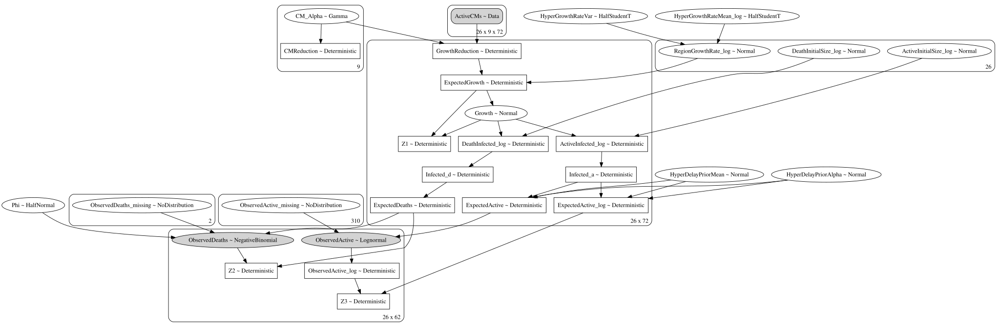

In [42]:
pm.model_to_graphviz(model).render("model-combined")
pm.model_to_graphviz(model)

In [43]:
model.run(2000, cores=8)

CM_Alpha_log__                       -12.77
HyperGrowthRateMean_log_log__         -0.77
HyperGrowthRateVar_log__              -0.77
RegionGrowthRate_log                   7.41
Growth                              1831.16
Phi_log__                             -0.77
DeathInitialSize_log                 -23.89
ObservedDeaths_missing                 0.00
HyperDelayPriorMean                   -2.02
HyperDelayPriorAlpha                  -1.32
ActiveInitialSize_log                -83.76
ObservedActive_missing                 0.00
ObservedDeaths                   -252871.73
ObservedActive                  -4041477.32
Name: Log-probability of test_point, dtype: float64


Multiprocess sampling (2 chains in 8 jobs)
INFO:pymc3:Multiprocess sampling (2 chains in 8 jobs)
CompoundStep
INFO:pymc3:CompoundStep
>NUTS: [ObservedActive_missing, ActiveInitialSize_log, HyperDelayPriorAlpha, HyperDelayPriorMean, DeathInitialSize_log, Phi, Growth, RegionGrowthRate_log, HyperGrowthRateVar, HyperGrowthRateMean_log, CM_Alpha]
INFO:pymc3:>NUTS: [ObservedActive_missing, ActiveInitialSize_log, HyperDelayPriorAlpha, HyperDelayPriorMean, DeathInitialSize_log, Phi, Growth, RegionGrowthRate_log, HyperGrowthRateVar, HyperGrowthRateMean_log, CM_Alpha]
>Metropolis: [ObservedDeaths_missing]
INFO:pymc3:>Metropolis: [ObservedDeaths_missing]
Sampling 2 chains, 0 divergences: 100%|██████████| 5000/5000 [1:34:03<00:00,  1.13s/draws]
The rhat statistic is larger than 1.4 for some parameters. The sampler did not converge.
ERROR:pymc3:The rhat statistic is larger than 1.4 for some parameters. The sampler did not converge.
The estimated number of effective samples is smaller than 200 for s

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/heldout_validation/out


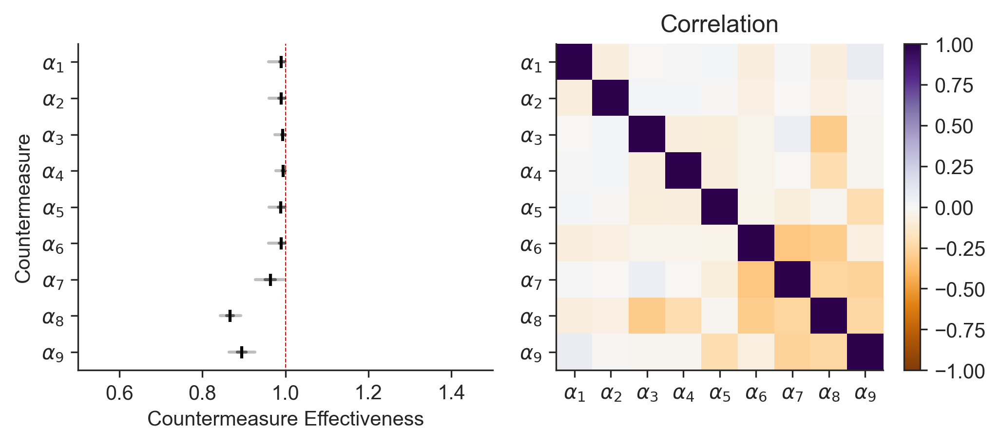

In [44]:
model.plot_effect()

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/heldout_validation/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/heldout_validation/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/heldout_validation/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/heldout_validation/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/heldout_validation/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/heldout_validation/out


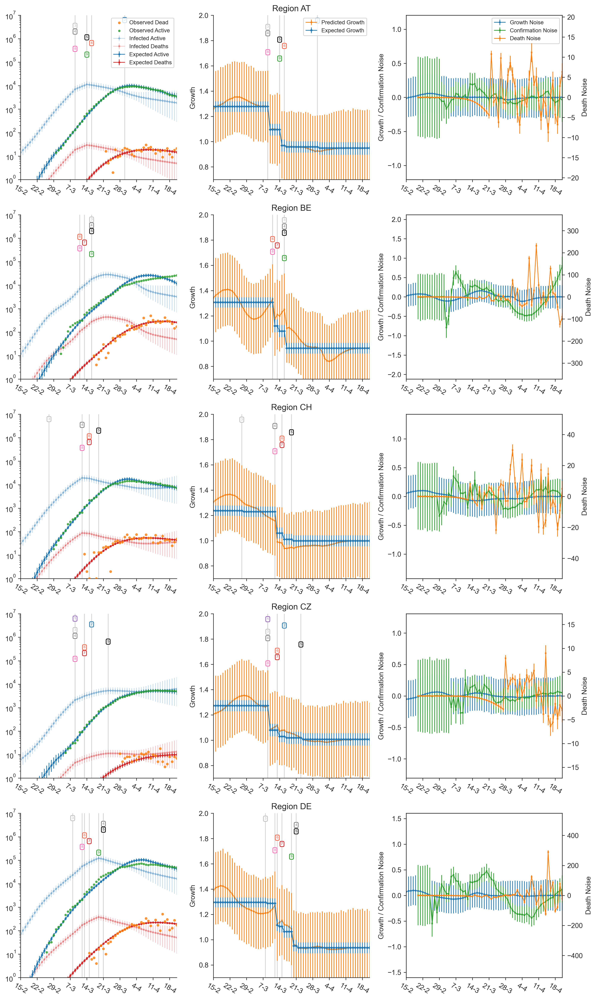

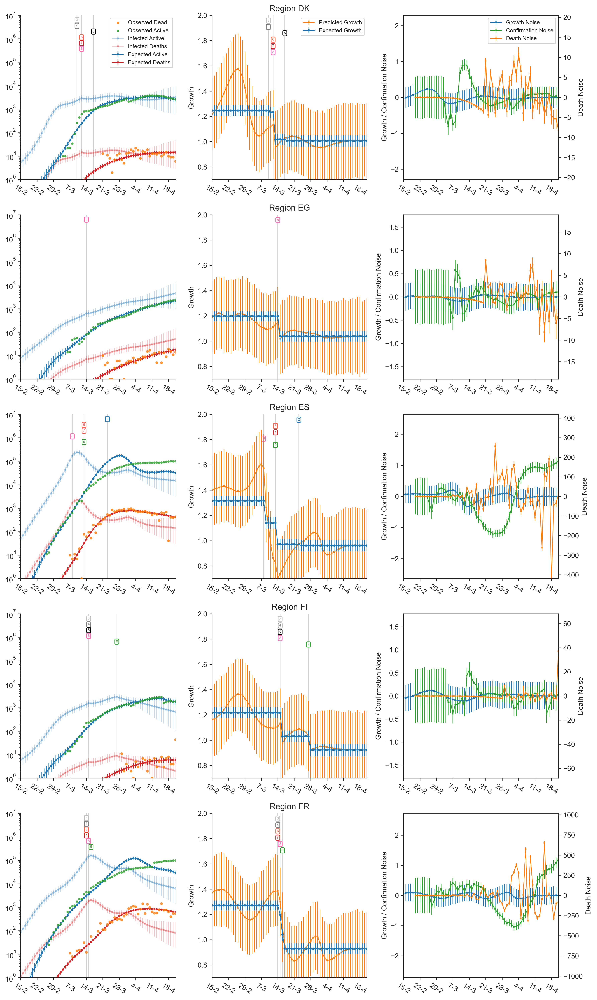

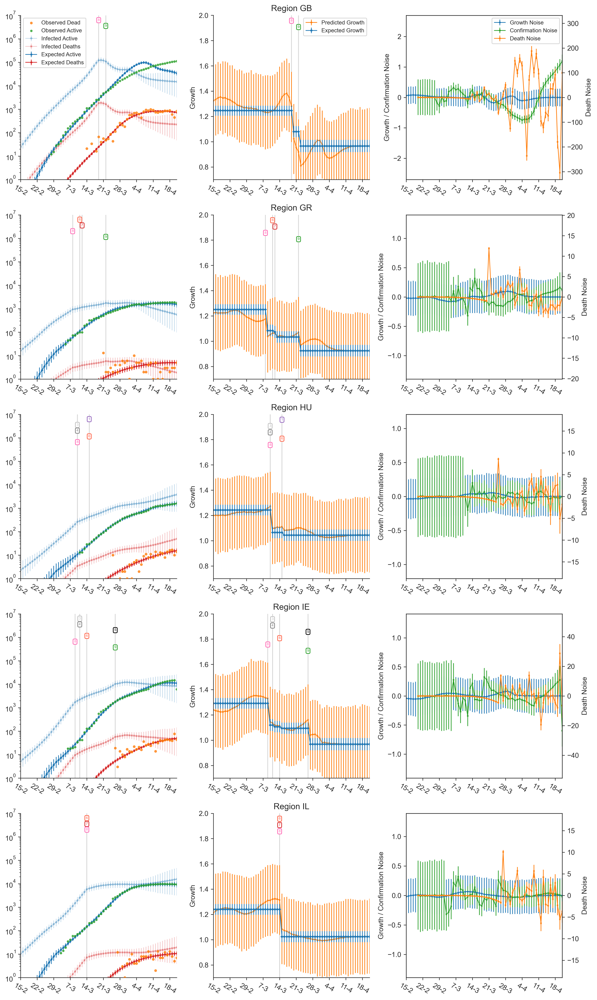

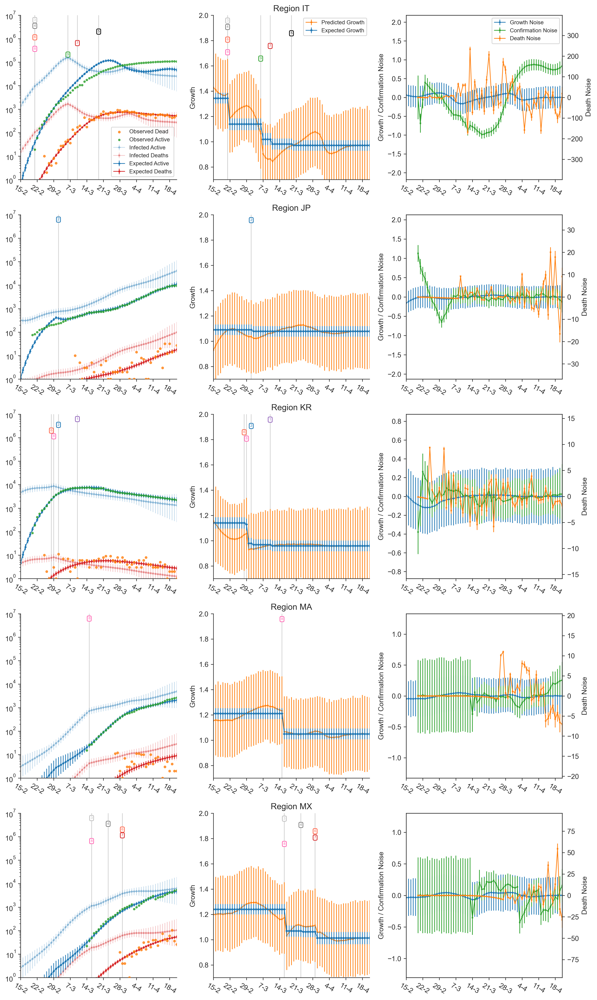

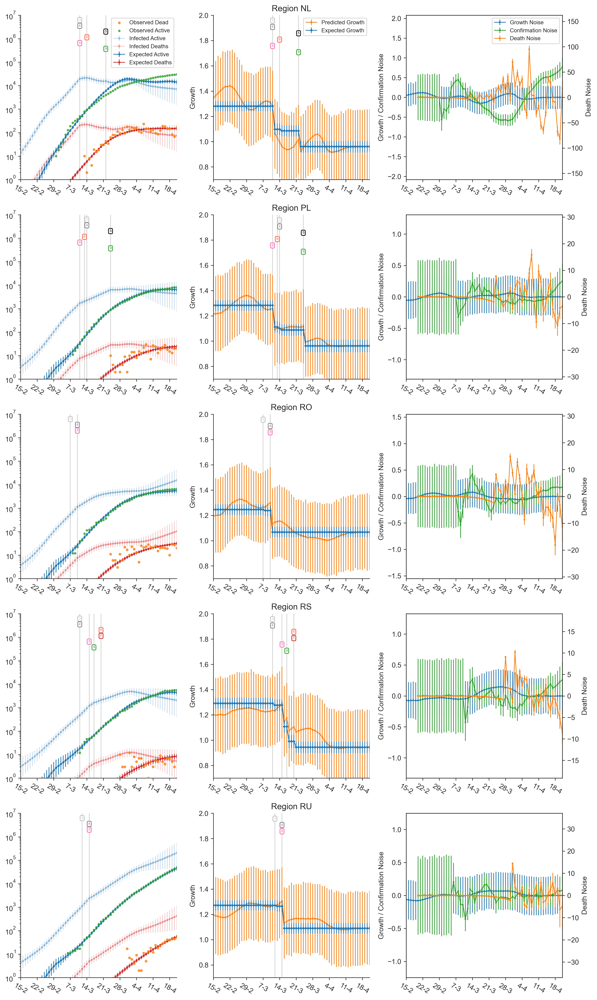

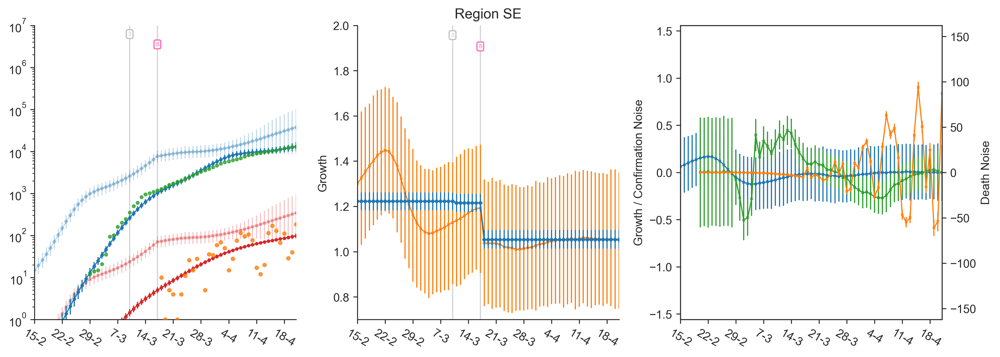

In [47]:
model.plot_region_predictions()

Text(0.5, 1.0, '11.99')

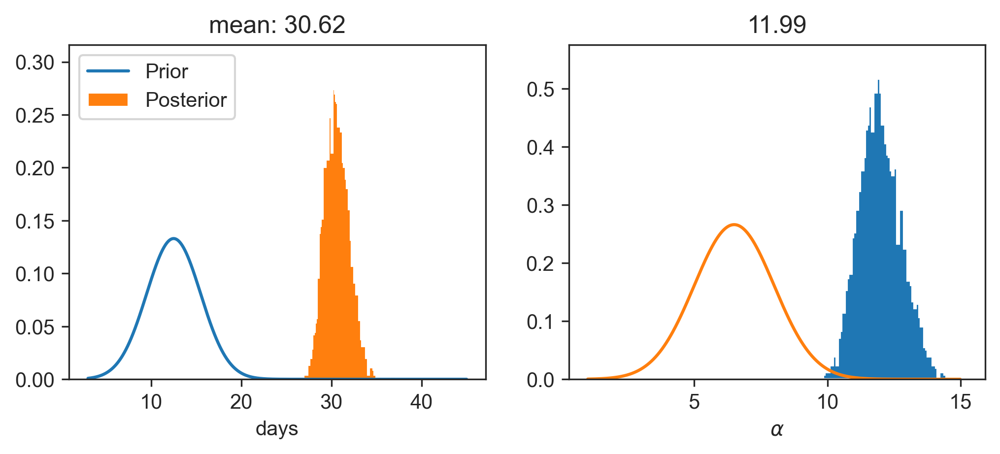

In [108]:
plt.figure(figsize=(8, 3), dpi=300)
plt.subplot(1, 2, 1)
prior = pm.Normal.dist(sigma=3, mu=12.5)
x = np.arange(3, 45, 0.01)
prior_vals = np.exp(prior.logp(x).eval())
plt.plot(x, prior_vals)
plt.hist(model.trace["HyperDelayPriorMean"], density=True, bins=100, histtype="stepfilled")
plt.legend(["Prior", "Posterior"])
plt.title(f"mean: {np.mean(model.trace['HyperDelayPriorMean']):.2f}")
plt.xlabel("days")

plt.subplot(1, 2, 2)
plt.hist(model.trace["HyperDelayPriorAlpha"], bins=100, density=True, histtype="stepfilled");
prior = pm.Normal.dist(sigma=1.5, mu=6.5)
plt.plot(np.arange(1, 15, 0.01), np.exp(prior.logp(np.arange(1, 15, 0.01)).eval()))
plt.xlabel(r"$\alpha$");
plt.title(f"{np.mean(model.trace['HyperDelayPriorAlpha']):.2f}")

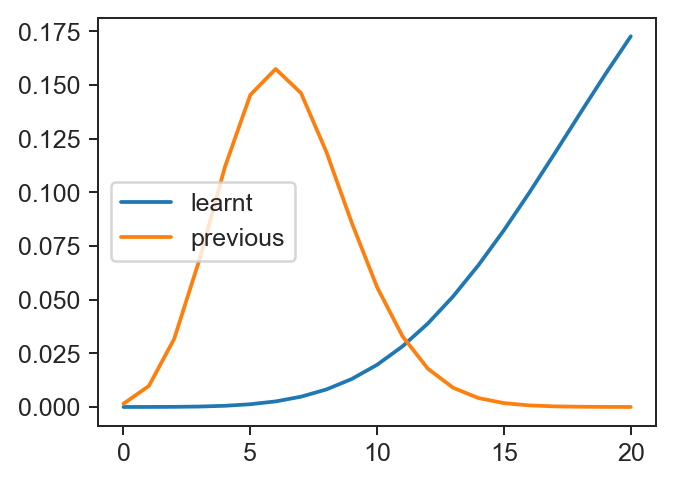

In [83]:
d1 = pm.NegativeBinomial.dist(mu=30.62, alpha=11.99)
d2 = pm.Poisson.dist(6.5)
x = np.arange(0, 21)
pdf = np.exp(d1.logp(x))
pdf = pdf / pdf.sum()
pdf2 = np.exp(d2.logp(x))
plt.figure(figsize=(4, 3), dpi=180)
plt.plot(x, pdf.eval(), label="learnt")
plt.plot(x, pdf2.eval(), label="previous")
plt.legend()

In [110]:
with cm_effect.models.CMCombined(data) as model:
    model.build_model()

/Users/mrinank/Library/Caches/pypoetry/virtualenvs/epimodel-H-ywULmv-py3.7/lib/python3.7/site-packages/pymc3/model.py:1430: ImputationWarning: Data in ObservedDeaths contains missing values and will be automatically imputed from the sampling distribution.
  warnings.warn(impute_message, ImputationWarning)
/Users/mrinank/Library/Caches/pypoetry/virtualenvs/epimodel-H-ywULmv-py3.7/lib/python3.7/site-packages/pymc3/model.py:1430: ImputationWarning: Data in ObservedActive contains missing values and will be automatically imputed from the sampling distribution.
  warnings.warn(impute_message, ImputationWarning)


In [111]:
model.run(2000)

CM_Alpha_log__                      -12.77
HyperGrowthRateMean_log_log__        -0.77
HyperGrowthRateVar_log__             -0.77
RegionGrowthRate_log                  7.41
Growth                             1831.16
Phi_log__                            -0.77
DeathInitialSize_log                -23.89
ObservedDeaths_missing                0.00
HyperDelayPriorMean                  -2.02
HyperDelayPriorAlpha                 -1.32
ActiveInitialSize_log               -83.76
ObservedActive_missing                0.00
ObservedDeaths                  -252871.73
ObservedActive                  -426850.99
Name: Log-probability of test_point, dtype: float64


Multiprocess sampling (2 chains in 2 jobs)
INFO:pymc3:Multiprocess sampling (2 chains in 2 jobs)
CompoundStep
INFO:pymc3:CompoundStep
>NUTS: [ObservedActive_missing, ActiveInitialSize_log, HyperDelayPriorAlpha, HyperDelayPriorMean, DeathInitialSize_log, Phi, Growth, RegionGrowthRate_log, HyperGrowthRateVar, HyperGrowthRateMean_log, CM_Alpha]
INFO:pymc3:>NUTS: [ObservedActive_missing, ActiveInitialSize_log, HyperDelayPriorAlpha, HyperDelayPriorMean, DeathInitialSize_log, Phi, Growth, RegionGrowthRate_log, HyperGrowthRateVar, HyperGrowthRateMean_log, CM_Alpha]
>Metropolis: [ObservedDeaths_missing]
INFO:pymc3:>Metropolis: [ObservedDeaths_missing]
Sampling 2 chains, 0 divergences: 100%|██████████| 5000/5000 [2:11:20<00:00,  1.58s/draws]  
The rhat statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
INFO:pymc3:The rhat statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
The estimated number of effe

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/heldout_validation/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/heldout_validation/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/heldout_validation/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/heldout_validation/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/heldout_validation/out
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/heldout_validation/out


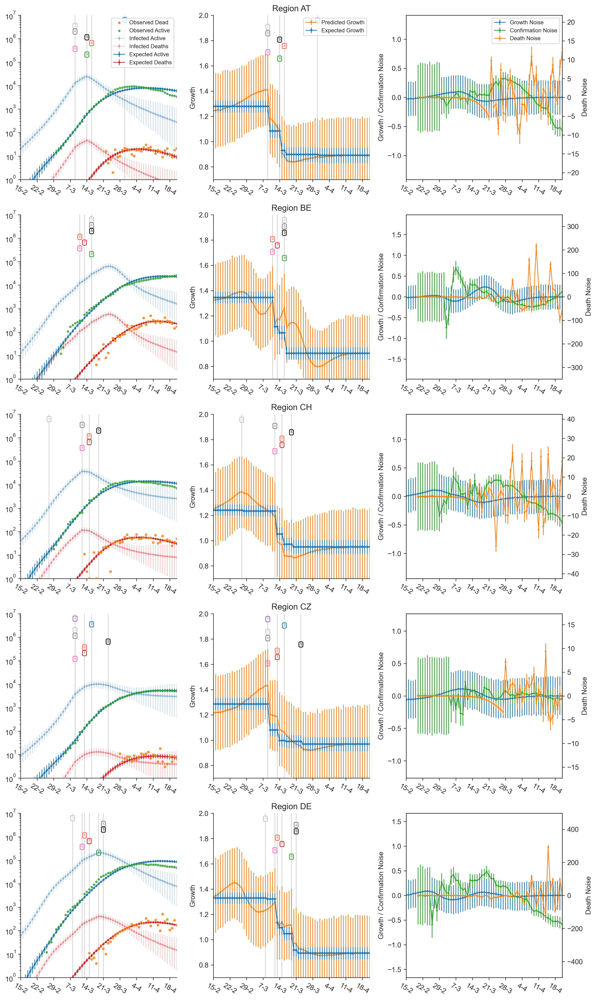

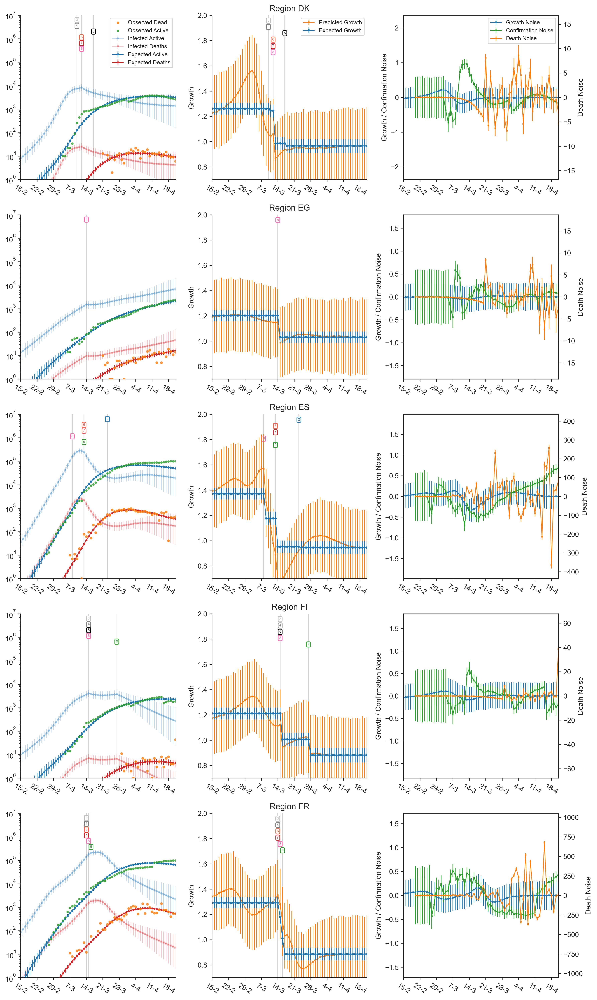

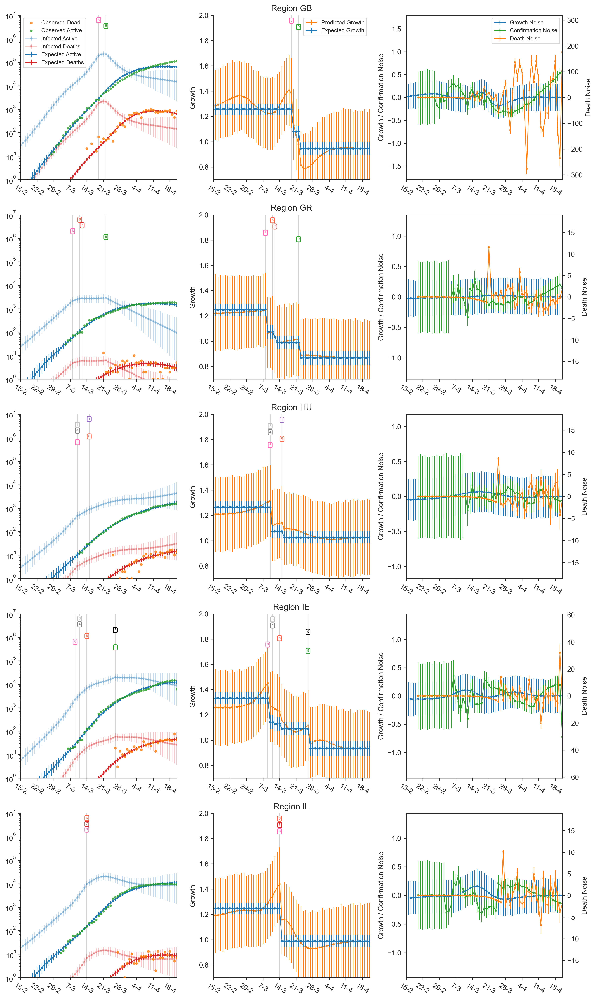

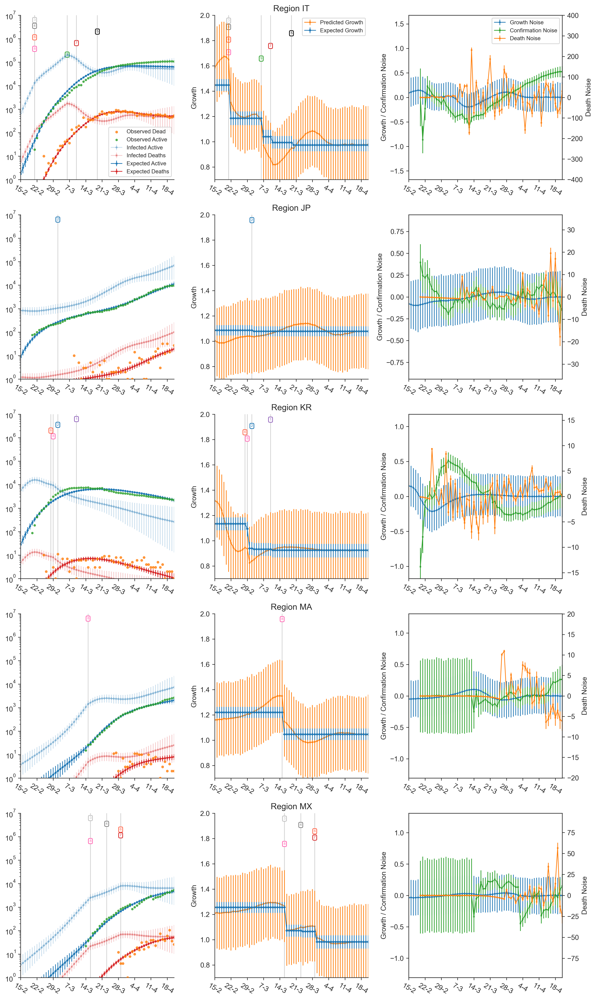

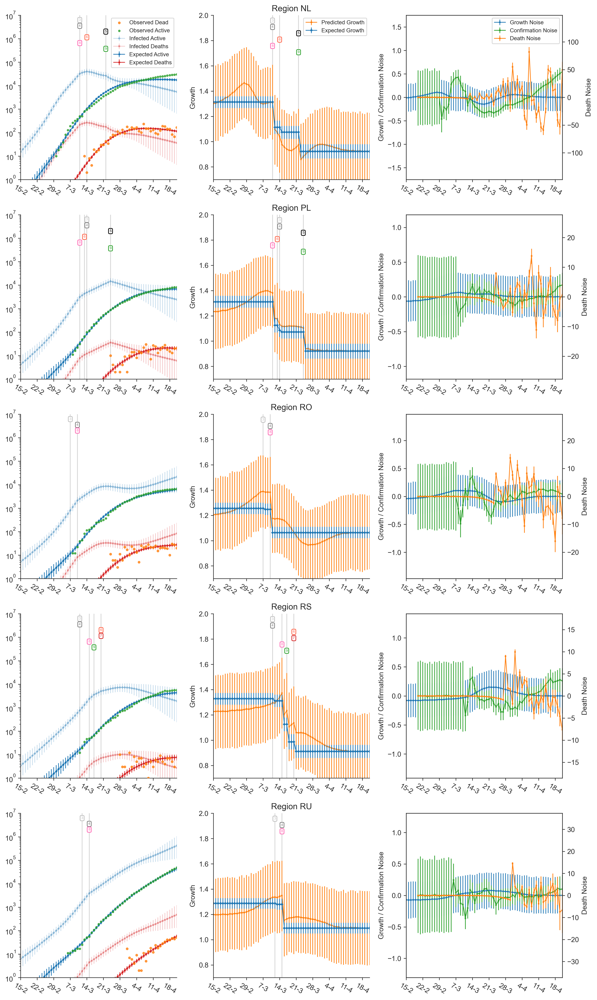

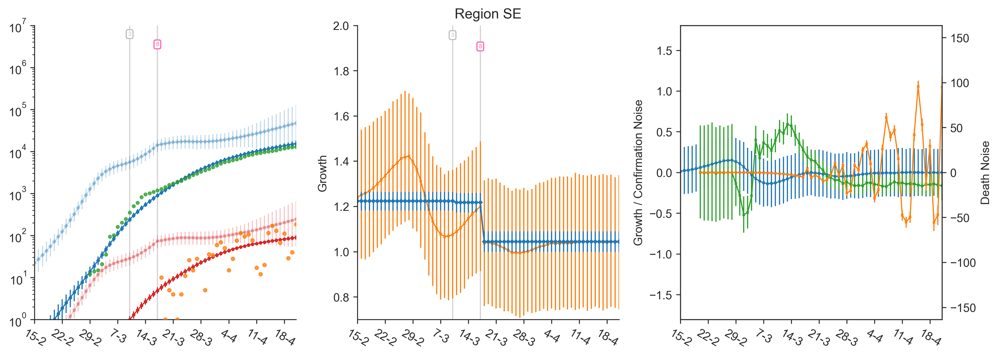

In [112]:
model.plot_region_predictions()

Text(0.5, 1.0, '4.39')

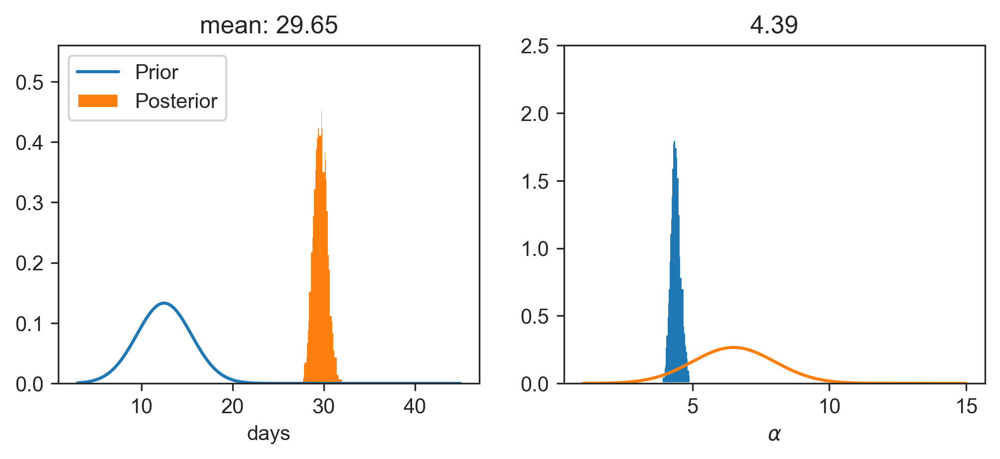

In [113]:
plt.figure(figsize=(8, 3), dpi=300)
plt.subplot(1, 2, 1)
prior = pm.Normal.dist(sigma=3, mu=12.5)
x = np.arange(3, 45, 0.01)
prior_vals = np.exp(prior.logp(x).eval())
plt.plot(x, prior_vals)
plt.hist(model.trace["HyperDelayPriorMean"], density=True, bins=100, histtype="stepfilled")
plt.legend(["Prior", "Posterior"])
plt.title(f"mean: {np.mean(model.trace['HyperDelayPriorMean']):.2f}")
plt.xlabel("days")

plt.subplot(1, 2, 2)
plt.hist(model.trace["HyperDelayPriorAlpha"], bins=100, density=True, histtype="stepfilled");
prior = pm.Normal.dist(sigma=1.5, mu=6.5)
plt.plot(np.arange(1, 15, 0.01), np.exp(prior.logp(np.arange(1, 15, 0.01)).eval()))
plt.xlabel(r"$\alpha$");
plt.title(f"{np.mean(model.trace['HyperDelayPriorAlpha']):.2f}")